## Visualising Fourier Transformations Using Sound Waves

- GitHub Repo: https://github.com/KyleAcheson/FFT_SoundWave
- More on University of Edinburgh Public Engagement: http://www.chem.ed.ac.uk/public-engagement
- More on Fourier Transforms: https://www.youtube.com/watch?v=spUNpyF58BY
- Contact: k.acheson@sms.ed.ac.uk

- To Run This Notebook: 
    - Click on a cell/ box of code - it will be highlighted in blue once selected.
    - Hit Shift and Enter keys on the highlighted cell at the same time.
    - Wait for cell to execute. While running you will notice the cell label changes from [number] to [*].
    - Read the cell output - printed below repsective box of code.
    - Remember that cells must be run sequentially.

#### What is the Fourier Series? 

The general idea is that if we take a periodic function, we can approximate it as a series of multiple sine and cosine waves.

Let us consider a periodic function $f(x)$, which for example could be a square, sawtooth or triangle wave as shown in the image below.

<img src="Images/WaveExample.png"
     alt="Markdown Monster icon"
     style="float: centre; margin-right: 10px;" />
     
     
     
If we take $f(x)$ and try to reconstruct it by adding numerous sine waves together with different frequencies.

Eventually, as we more towards an infinite number of sine waves, we will recreate the true shape of the function $f(x)$. This is not only true for the functions in this image, but for any periodic function.

Mathmatically, this can be written as:
$f(x) =  \sum _{n=1}^{\inf} [a_{n} cos(nx) + b_{n} sin(nx)]$,

where $\sum$ represents a sum over n values from 1 to infinity, and $a{n}$ and $b_{n}$ are the fourier coefficients that scale the wave accordingly.

#### Why is this important? The Fourier Transform... 

The Fourier series approximates $f(x)$ which is a function of time, by a number of sine and cosine waves with different frequencies. From this, comes the Fourier transform, which allows us to take an time-dependent periodic signal, and decompose it into a series of sine and cosine waves with differing frequencies. This transformation, allows one to pick out different frequencies from some measured signal. This transformation is widely used in STEM fields. For example, MRI machines use Fourier transforms to transform a time-dependent signal to the frequencey domain, from this one can analyse the signal. Fourier transforms are also widely used for signal analysis in electrocardiograms, several types of spectroscopy and of sound waves. 

In this notebook we shall explore the application to sound waves. For example, you can take a series of sound waves that corrospond to human speech, perform a Fourier transform in order to decompose and catagorise speech by frequencey, an algorithm can then be devised to relate these frequencies to different phonetics and determine what is being said (Siri/ Alexa will have been trained in such a maner). Another example would be to Fourier transform the sound wave resulting from playing a muscial instrument, and pick out the different frequencies that corrospond to different notes being played. There are in fact, applications that will listen to a song, Fourier transform the sound wave and tell you what notes are being played. 



### Loading Modules Needed

In [2]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import scipy
import random
from os import listdir, getcwd
from IPython.display import Audio, display
from scipy.integrate import quad, simps
from ipywidgets import interact
import ipywidgets as widgets

print('Task Finished.')

Task Finished.


### Example - Constructing an Example Signal From a Series of Sinusoidal Waves

Frequencies: [3, 1, 1, 7, 10]
Task Finished.


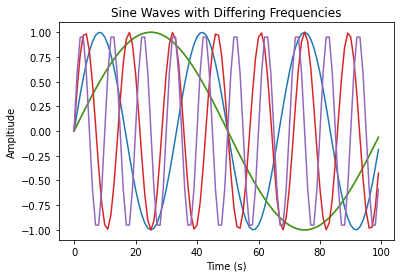

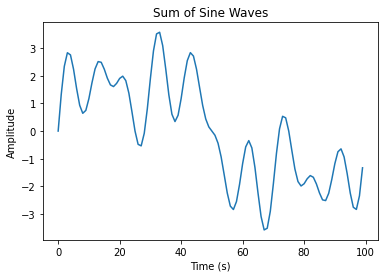

In [3]:
#freqs = [3 4 9 4 9 3] # Uncomment by removing '#' and edit to see how this changes
freqs = [random.randint(1, 10) for i in range(5)] # Randomly generate frequencies - Comment with '#' if specifying own freqs

Nsamples = 100
time_vec = np.arange(Nsamples)
sum_y = np.zeros(int(Nsamples))
plt.figure()
for freq in freqs:
    y = np.sin(2 * np.pi * freq * (time_vec / Nsamples))
    sum_y = sum_y + y
    plt.plot(time_vec, y)
    
plt.xlabel('Time (s)')
plt.ylabel('Ampltiude')
plt.title('Sine Waves with Differing Frequencies')

plt.figure()
plt.plot(time_vec, sum_y)
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Sum of Sine Waves')

#-(exp(-n*x*1i)*(- n^2*x^2 + n*x*2i + 2)*1i)/n^3   # TO FIX
#-(2*exp(-n*x*1i)*(3*sin(3*x) - n*cos(3*x)*1i))/(n^2 - 9)
#def fcoeffs(signal, x, n):
#   cAList = []
#    cBList = []
#    for i in range(n):
#        integrandA = np.multiply(signal,np.sin(n*x))
#        integrandB = np.multiply(signal,np.cos(n*x))
        #integrand = -(2*np.exp(-n*x*1j)*(3*np.sin(3*x)-n*np.cos(3*x)*1j))/(n**2 - 9)
#        c_a = 1/(2*np.pi)*integrandA
#        c_b = 1/(2*np.pi)*integrandB
#        cAList.append(c_a)
#        cBList.append(c_b)
#    return cAList, cBList

#def fseries(cA, cB, x):
#    sum_series = np.zeros(len(x))
#    for n, coeff in enumerate(zip(cA, cB)):
#        n += 1
#        term_a = np.multiply(coeff[0], np.sin(n*x))
#        term_b = np.multiply(coeff[1], np.cos(n*x))
#        sum_ab = term_a + term_b
#        sum_series = sum_series + sum_ab
#    return sum_series

#def plotfs(c):
#    plt.figure()
#    [cA, cB] = fcoeffs(sum_y, time_vec, 1)
#    fser = fseries(cA, cB, time_vec)
#    plt.plot(time_vec, fser)

#interact(plotfs, c = widgets.FloatSlider(value=1, min=1, max=10, step=1))

#cA, cB = fcoeffs(sum_y, time_vec, 1)
#fser = fseries(cA, cB, time_vec)
#plt.figure()
#plt.plot(time_vec, fser)

print('Frequencies: %s' % freqs)
print('Task Finished.')

### Using Fast Fourier Transform Algorithm to Take the FT of Sine Wave Sum

Frequencies Used: [3, 1, 1, 7, 10].
Magnitude corrosponds to number of waves with this frequency.


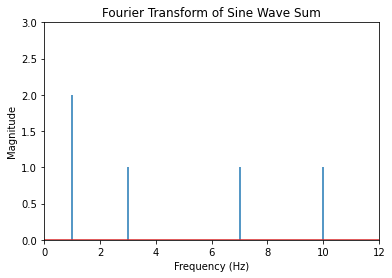

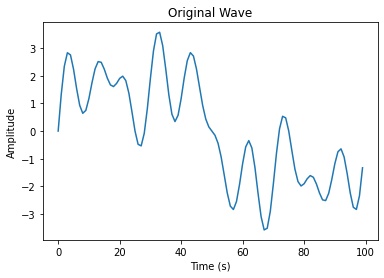

interactive(children=(FloatSlider(value=1.0, description='c', max=4.0, min=1.0, step=1.0), Output()), _dom_cla…

Slide the bar to observe how the approximation of the series improves on including more sine waves.
Task Finished.


In [4]:
def fft(signal, sampling_rate):
    n = len(signal)
    T = 1/sampling_rate
    fft_signal = scipy.fft.fft(signal)
    freq_vec = np.linspace(1, int(1.0/(2.0*T)), int(n/2))
    freq_vec = [i-1 for i in freq_vec]
    fft_signal = (2.0/n) * np.abs(fft_signal[:n//2])
    return freq_vec, fft_signal

[freq_vec, fft_signal] = fft(sum_y, Nsamples)
plt.figure()
plt.stem(freq_vec, fft_signal, markerfmt= ' ')
plt.xlabel('Frequency (Hz)')
plt.xlim([0, max(freqs)+2])
plt.ylabel('Magnitude')
plt.ylim([0, max(fft_signal)+1])
plt.title('Fourier Transform of Sine Wave Sum')

print('Frequencies Used: %s.' % freqs)
print('Magnitude corrosponds to number of waves with this frequency.')

plt.figure()
plt.plot(time_vec, sum_y)
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Original Wave')

Alist = []
flist = []
for i in range(len(fft_signal)):
    if fft_signal[i] >= 0.9:
        Alist.append(fft_signal[i])
        flist.append(freq_vec[i])
        

def fseries(c):
    plt.figure()
    Sums = np.zeros(len(time_vec))
    for i in range(int(c)):
        s = Alist[i]*np.sin(2 * np.pi * flist[i] * (time_vec / Nsamples))
        Sums = Sums + s
        if i < len(Alist)-1:
            plt.plot(time_vec, Sums, alpha=0.15)
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')
            plt.title('Convergence of Fourier Series for Original Signal')
        else:
            plt.plot(time_vec, Sums)
    
interact(fseries, c = widgets.FloatSlider(value=1, min=1, max=len(Alist), step=1))
print('Slide the bar to observe how the approximation of the series improves on including more sine waves.')

print('Task Finished.')
    

### List Available Sounds

In [7]:
SoundDir = getcwd()+'/Sounds/'
SoundList = [f for f in listdir(SoundDir) if 'wav' in f]
for idx, fname in enumerate(SoundList):
    print('Index %s: ' % idx)
    print(fname+'\n')
    
print("In the following cell edit the variable 'Index' on the first line to the Index corrosponding to your chosen sound.")

Index 0: 
Crickets.wav

Index 1: 
Eagle.wav

Index 2: 
Lion.wav

Index 3: 
Dolphin.wav

Index 4: 
Bat.wav

Index 5: 
HumpbackWhale.wav

Index 6: 
Wolves.wav

Index 7: 
GrizzlyBear.wav

In the following cell edit the variable 'Index' on the first line to the Index corrosponding to your chosen sound.


### Defining Sound Wave Signal for Audio File - Edit Index on First Line

In [8]:
Index = 0  # EDIT - To chosen index as listed above

try:
    filepath = SoundDir + SoundList[Index]
    display(Audio(filepath))
    filename = filepath.split('/')[-1]
    samples, sampling_rate = librosa.load(filepath, sr=None, mono=True, offset=0.0, duration=None)
    sound_duration = len(samples)/sampling_rate
    print("Click play button above to listen to sound.")
    print("Input recording '%s' has a duration of %s seconds." % (filename, sound_duration))
    print("Sampling input audio at a rate of %s amplitudes per second." % sampling_rate)
    print('Task Finished.')
except IndexError as err:
    print("ERROR: %s, please choose an 'Index' from %s listed above." % (err, [i for i in range(len(SoundList))]))
    
    

Click play button above to listen to sound.
Input recording 'Crickets.wav' has a duration of 101.04164583333333 seconds.
Sampling input audio at a rate of 48000 amplitudes per second.
Task Finished.


### Plotting Sound Waveform

Task Finished.


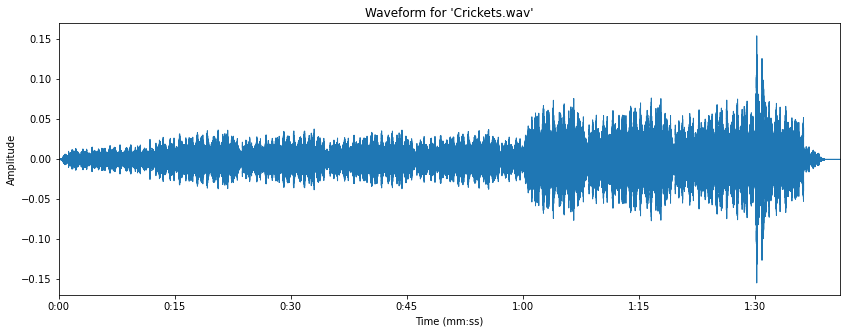

In [9]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(y=samples, sr=sampling_rate)
plt.xlabel('Time (mm:ss)')
plt.ylabel('Amplitude')
plt.title("Waveform for '%s'" % filename)

print('Task Finished.')

### FFT of Signal from Audio File

Sound wave (cell above) in time domain transformed to frequency domain.

Now select different sound waves and observe the frequencies of typical animal sounds or songs.
You can do this by returning to the cell titled 'Defining Sound Wave Signal for Audio File - Edit Index on First Line'
change the index and execute the subsequent cells again. See how the frequencies of the sound wave changes.

E.g. you may notice how the Lion's roar is very low frequencey vs the Bat's sound.

Task Finished.


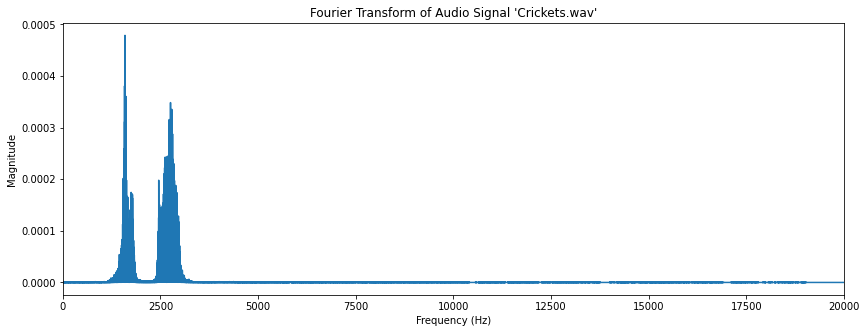

In [10]:
[freq_vec, fft_signal] = fft(samples, sampling_rate)
plt.figure(figsize=(14, 5))
plt.plot(freq_vec, fft_signal)
plt.xlabel('Frequency (Hz)')
plt.xlim([0, 20000])
plt.ylabel('Magnitude')
plt.title("Fourier Transform of Audio Signal '%s'" % filename)

print('Sound wave (cell above) in time domain transformed to frequency domain.\n')
print('Now select different sound waves and observe the frequencies of typical animal sounds or songs.')
print("""You can do this by returning to the cell titled 'Defining Sound Wave Signal for Audio File - Edit Index on First Line'
change the index and execute the subsequent cells again. See how the frequencies of the sound wave changes.\n""")
print("E.g. you may notice how the Lion's roar is very low frequencey vs the Bat's sound.\n" )
print('Task Finished.')
